In [5]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

<h1>Background</h1>

Monet style images generation

This Kaggle competition focuses on building a Generative Adversarial Network (GAN) capable of generating 7,000 to 10,000 Monet style images from real world photos. The goal is to train a model that can transform natural photographs into images that resemble the artistic style of Claude Monet, capturing his color palette, brushstroke patterns, contrast, and overall artistic feel.

What is GAN?

Generative Adversarial Network (GAN) is a deep learning model that uses two competing neural networks—a generator and a discriminator—to create new, realistic data that is similar to a training dataset. The generator creates fake data, while the discriminator tries to distinguish between the real data and the fake data. This adversarial competition drives both networks to improve: the generator gets better at creating convincing fakes, and the discriminator gets better at spotting them.(from https://aws.amazon.com/what-is/gan/)

Evaluation metric: MiFID

MiFID is a specialized adaptation of the Fréchet Inception Distance (FID)—a commonly used metric for evaluating generative models. It measures how close the generated images are to the real Monet paintings. Lower MiFID scores indicate better performance.

In [6]:
import random
import matplotlib.pyplot as plt
from PIL import Image
from glob import glob
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torchvision.utils as vutils
import torchvision.transforms as T

from scipy.spatial.distance import cosine


In [7]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)

Using device: cpu


In [8]:
# Training config
IMG_SIZE = 256         
BATCH_SIZE = 4     
LR = 2e-4
NUM_EPOCHS = 40      
LAMBDA_CYCLE = 10
LAMBDA_IDENTITY = 5        # identity loss weight
SAVE_EVERY = 1         # save sample per epoch
MAX_STEPS = 40

SEED = 42

random.seed(SEED)
torch.manual_seed(SEED)
np.random.seed(SEED)

print(f"IMG_SIZE={IMG_SIZE}, BATCH_SIZE={BATCH_SIZE}, LR={LR}, EPOCHS={NUM_EPOCHS}")

IMG_SIZE=256, BATCH_SIZE=4, LR=0.0002, EPOCHS=40


<h1>Data</h1>
<p>The dataset contains two distinct collections of images: Monet-style paintings and photographic landscape images. These datasets are unpaired, meaning there is no direct 1 to 1 mapping between a photo and a Monet painting. This makes the problem an unpaired image to image translation task, which is why CycleGAN is an appropriate model choice.</p>


What is CycleGAN?

CycleGAN is a type of Generative Adversarial Network designed for unpaired image-to-image translation. Unlike traditional GANs, which require paired examples, CycleGAN can learn mappings without paired training data.


Why I Use the JPG Files

The dataset provides both JPG images and TFRecord files, I chose to use the JPG versions because PyTorch does not natively read TFRecord files and JPG files are easier for previewing in the pipeline.



In [9]:
MONET_JPG = "/kaggle/input/gan-getting-started/monet_jpg/"
PHOTO_JPG = "/kaggle/input/gan-getting-started/photo_jpg/"

monet_paths = sorted(glob(MONET_JPG + "*.jpg"))
photo_paths = sorted(glob(PHOTO_JPG + "*.jpg"))

len(monet_paths), len(photo_paths)

(300, 7038)

<h2>Images Preview</h2>
Preview the difference between Monet images and Photo images

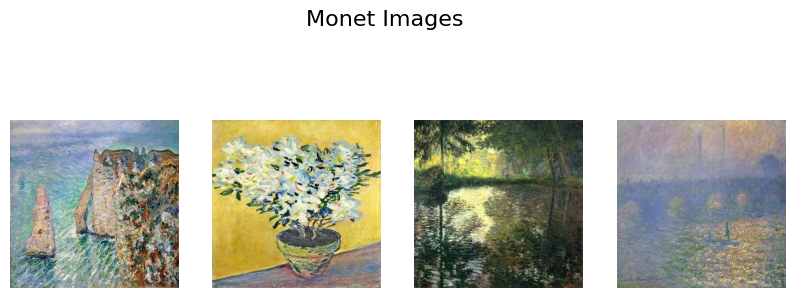

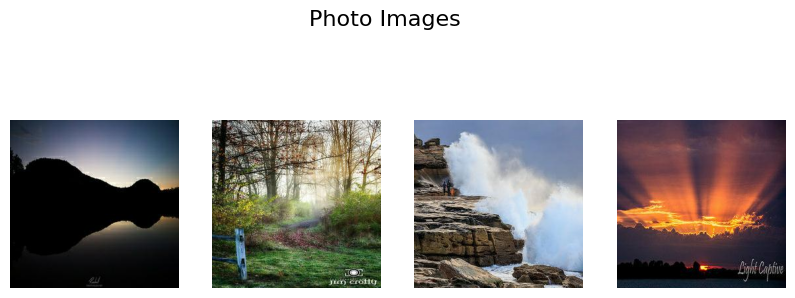

In [10]:
def show_random(folder, title):
    files = random.sample(glob(folder + "*.jpg"), 4)
    plt.figure(figsize=(10,4))
    plt.suptitle(title, fontsize=16)
    for i, f in enumerate(files):
        plt.subplot(1,4,i+1)
        plt.imshow(Image.open(f))
        plt.axis("off")
    plt.show()

show_random(MONET_JPG, "Monet Images")
show_random(PHOTO_JPG, "Photo Images")

<h1>EDA</h1>

<h3>Duplicate check</h3>
There are duplicate images in the Photo datasets, so I remove them to ensure that the GAN will not memorize repeated images.

<h3>Balance check</h3>
Since the number of Monet images is 300 and the number of photos is 7068, they are unbalanced. So I am cycling the Monet images to make sure there is a Monet image training with a photo.

<h3>RGB check</h3>
After analyzing the color distributions across both datasets, Monet images are generally brighter with more pixels in the higher intensity ranges. This difference highlights the characteristic color style of Monet paintings, which the GAN will learn to emulate.

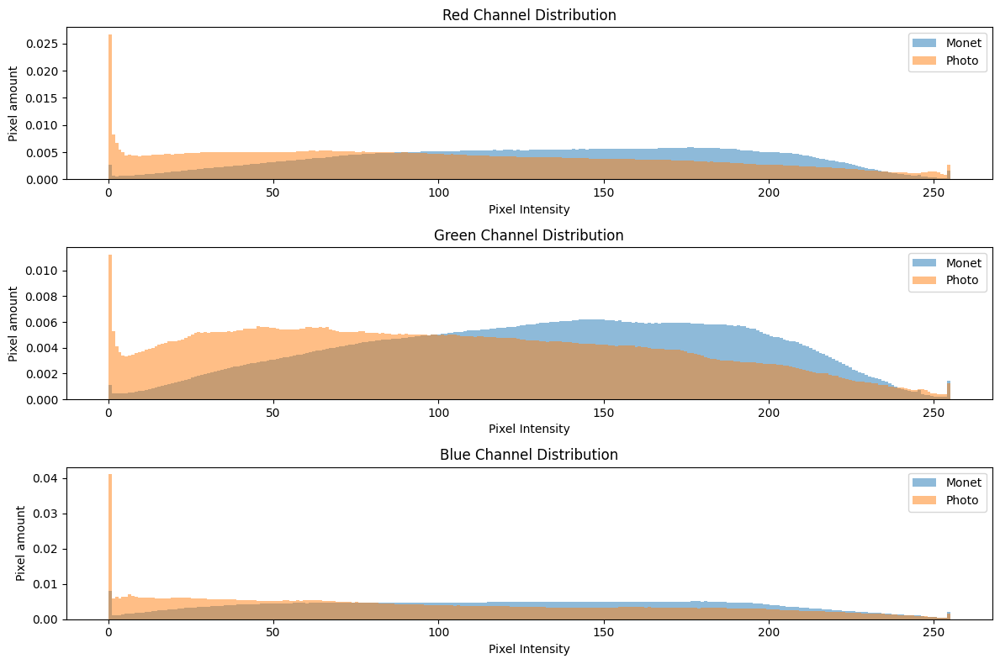

In [21]:
def get_rgb_values(paths, sample_size=300):
    values = []
    for p in paths[:sample_size]:
        img = Image.open(p).convert("RGB")
        img_np = np.array(img)
        values.append(img_np.reshape(-1, 3))
    values = np.vstack(values)
    return values[:,0], values[:,1], values[:,2]  # R,G,B

monet_r, monet_g, monet_b = get_rgb_values(monet_paths)
photo_r, photo_g, photo_b = get_rgb_values(photo_paths)

plt.figure(figsize=(12,8))

# Red
plt.subplot(3,1,1)
plt.hist(monet_r, bins=256, alpha=0.5, label="Monet", density=True)
plt.hist(photo_r, bins=256, alpha=0.5, label="Photo", density=True)
plt.title("Red Channel Distribution")
plt.xlabel("Pixel Intensity")
plt.ylabel("Pixel amount")
plt.legend()

# Green
plt.subplot(3,1,2)
plt.hist(monet_g, bins=256, alpha=0.5, label="Monet", density=True)
plt.hist(photo_g, bins=256, alpha=0.5, label="Photo", density=True)
plt.title("Green Channel Distribution")
plt.xlabel("Pixel Intensity")
plt.ylabel("Pixel amount")
plt.legend()

# Blue
plt.subplot(3,1,3)
plt.hist(monet_b, bins=256, alpha=0.5, label="Monet", density=True)
plt.hist(photo_b, bins=256, alpha=0.5, label="Photo", density=True)
plt.title("Blue Channel Distribution")
plt.xlabel("Pixel Intensity")
plt.ylabel("Pixel amount")
plt.legend()

plt.tight_layout()
plt.show()

In [27]:
import imagehash
from collections import defaultdict

def find_duplicates(image_paths):
    hash_dict = defaultdict(list)

    print(f"Checking {len(image_paths)} images...")

    for path in image_paths:
        try:
            img = Image.open(path).convert("RGB")
            h = imagehash.phash(img)     # perceptual hash
            hash_dict[str(h)].append(path)
        except Exception as e:
            print(f"Error reading {path}: {e}")

    # Extract only entries with duplicates
    duplicates = {h: paths for h, paths in hash_dict.items() if len(paths) > 1}
    return duplicates

# Load both folders
monet_files = sorted([os.path.join(MONET_JPG, f) for f in os.listdir(MONET_JPG)])
photo_files = sorted([os.path.join(PHOTO_JPG, f) for f in os.listdir(PHOTO_JPG)])

monet_duplicates = find_duplicates(monet_files)
photo_duplicates = find_duplicates(photo_files)

print("=== Monet duplicates ===")
for h, files in monet_duplicates.items():
    print(h, ":", files)

print("\n=== Photo duplicates ===")
for h, files in photo_duplicates.items():
    print(h, ":", files)

Checking 300 images...
Checking 7038 images...
=== Monet duplicates ===

=== Photo duplicates ===
c0c42f6de63c48dd : ['/kaggle/input/gan-getting-started/photo_jpg/02d763f1c2.jpg', '/kaggle/input/gan-getting-started/photo_jpg/1c69470718.jpg']
94b12f5af4294ed2 : ['/kaggle/input/gan-getting-started/photo_jpg/06058e6cb0.jpg', '/kaggle/input/gan-getting-started/photo_jpg/f247ca8a34.jpg']
8144792fb6dd6691 : ['/kaggle/input/gan-getting-started/photo_jpg/16a666edff.jpg', '/kaggle/input/gan-getting-started/photo_jpg/1dafe2cf42.jpg', '/kaggle/input/gan-getting-started/photo_jpg/b76490cea4.jpg']
a0a05ed6906f4f3e : ['/kaggle/input/gan-getting-started/photo_jpg/1d7d8ff0ac.jpg', '/kaggle/input/gan-getting-started/photo_jpg/643916e05b.jpg']
c5e3f5623bc242d8 : ['/kaggle/input/gan-getting-started/photo_jpg/2641b8175f.jpg', '/kaggle/input/gan-getting-started/photo_jpg/2bb040da92.jpg']
906f6b847789788d : ['/kaggle/input/gan-getting-started/photo_jpg/2960920920.jpg', '/kaggle/input/gan-getting-started/pho

In [29]:
def remove_duplicate_images(image_paths):
    """
    Remove duplicate images based on perceptual hash (pHash).
    Returns a list of unique image paths.
    """
    hash_dict = defaultdict(list)
    unique_paths = []

    for path in image_paths:
        try:
            img = Image.open(path).convert("RGB")
            h = str(imagehash.phash(img))
            hash_dict[h].append(path)
        except Exception as e:
            print(f"Error reading {path}: {e}")

    # Keep only the first image from each hash group
    for paths in hash_dict.values():
        unique_paths.append(paths[0])

    return unique_paths

# Original paths
monet_paths = sorted([os.path.join(MONET_JPG, f) for f in os.listdir(MONET_JPG)])
photo_paths = sorted([os.path.join(PHOTO_JPG, f) for f in os.listdir(PHOTO_JPG)])

# Remove duplicates
monet_paths_unique = remove_duplicate_images(monet_paths)
photo_paths_unique = remove_duplicate_images(photo_paths)

print(f"Monet images: {len(monet_paths)} -> {len(monet_paths_unique)} after removing duplicates")
print(f"Photo images: {len(photo_paths)} -> {len(photo_paths_unique)} after removing duplicates")

Monet images: 300 -> 300 after removing duplicates
Photo images: 7038 -> 7014 after removing duplicates


In [31]:
# DATASET CLASS

class ImageDataset(Dataset):
    def __init__(self, monet_paths, photo_paths, transforms):
        self.monet_paths = monet_paths
        self.photo_paths = photo_paths
        self.transforms = transforms

    def __len__(self):
        return max(len(self.monet_paths), len(self.photo_paths))

    def __getitem__(self, idx):
        monet_img = Image.open(self.monet_paths[idx % len(self.monet_paths)]).convert("RGB")
        photo_img = Image.open(self.photo_paths[idx % len(self.photo_paths)]).convert("RGB")
        return {
            "monet": self.transforms(monet_img),
            "photo": self.transforms(photo_img)
        }

In [32]:
transforms = T.Compose([
    T.Resize((IMG_SIZE, IMG_SIZE)),
    T.ToTensor(),
    T.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)) 
])

dataset = ImageDataset(monet_paths_unique, photo_paths_unique, transforms)
loader = DataLoader(dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=2)
len(loader)

1754

<h1>Model Architecture</h1>

CycleGAN has two generators and two discriminators. The idea is one generator turns photos into Monet-style paintings, and the other turns Monet paintings back into photos. The discriminators help the generators improve by trying to tell real from fake images.

The PatchGAN discriminator converts the 256*256 image into a 31*31 patch map. It outputs a map of scores, which has one score per receptive patch in the input image.

For residual block, I applied two 3×3 convolutions, with instance norm + ReLU between them, then added the input back. So output = x + F(x). This residual connection helps training deeper networks by allowing gradients to flow through the identity path.

ResNet Generator
Inital create a 7×7 large kernel helps capture larger context,then downsampling with 2 convolution layers,apply residual block to keep the connection, then upsampling 2 convolution layers back to resize the image to 256*256. Finally, let's produce 3×256×256 output in range -1 to 1.

In [9]:
# --- PatchGAN Discriminator ---
class Discriminator(nn.Module):
    def __init__(self, in_channels=3):
        super().__init__()
        def block(input_dim, output_dim, norm=True):
            layers = [nn.Conv2d(input_dim, output_dim, 4, 2, 1)]
            if norm:
                layers.append(nn.InstanceNorm2d(output_dim))
            layers.append(nn.LeakyReLU(0.2, True))
            return layers

        self.model = nn.Sequential(
            *block(in_channels, 64, norm=False),
            *block(64, 128),
            *block(128, 256),
            nn.Conv2d(256, 1, 4, 1, 1)
        )

    def forward(self, x):
        return self.model(x)


# --- Residual Block ---
class ResidualBlock(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.block = nn.Sequential(
            nn.Conv2d(dim, dim, 3, 1, 1),
            nn.InstanceNorm2d(dim),
            nn.ReLU(True),
            nn.Conv2d(dim, dim, 3, 1, 1),
            nn.InstanceNorm2d(dim)
        )

    def forward(self, x):
        return x + self.block(x)


# --- ResNet Generator ---
class Generator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3, n_residuals=6):
        super().__init__()

        model = [
            nn.Conv2d(in_channels, 64, 7, 1, 3),
            nn.InstanceNorm2d(64),
            nn.ReLU(True)
        ]

        # Downsampling
        dims = [64, 128, 256]
        for i in range(2):
            model += [
                nn.Conv2d(dims[i], dims[i+1], 3, 2, 1),
                nn.InstanceNorm2d(dims[i+1]),
                nn.ReLU(True)
            ]

        for _ in range(n_residuals):
            model.append(ResidualBlock(256))

        # Upsampling
        for i in range(2):
            model += [
                nn.ConvTranspose2d(dims[2-i], dims[1-i], 3, 2, 1, output_padding=1),
                nn.InstanceNorm2d(dims[1-i]),
                nn.ReLU(True)
            ]

        model += [
            nn.Conv2d(64, out_channels, 7, 1, 3),
            nn.Tanh()
        ]

        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)


GANs needs 2 generators: one is to take a real photo and generates a Monet-style image. Another one is to take a Monet painting and generates a realistic photo.

Then we also got 2 discriminators: one is to decides if an image is a real Monet image or a fake Monet image. Another one is to decide if an image is a real photo or a fake photo.

<h2>Loss function</h2> 

This project I am using MSE and L1 loss function.

MSELoss stabilizes training, avoids vanishing gradients, and usually produces smoother images. BCE can lead to instability and mode collapse in GANs.

L1 encourages less blurring than L2 loss.

In [10]:
G_PHOTO2MONET = Generator().to(device)
G_MONET2PHOTO = Generator().to(device)

D_MONET = Discriminator().to(device)
D_PHOTO = Discriminator().to(device)

g_opt = optim.Adam(
    list(G_PHOTO2MONET.parameters()) + list(G_MONET2PHOTO.parameters()),
    lr=LR, betas=(0.5, 0.999)
)
d_opt = optim.Adam(
    list(D_MONET.parameters()) + list(D_PHOTO.parameters()),
    lr=LR, betas=(0.5, 0.999)
)

adv_criterion = nn.MSELoss()
cycle_criterion = nn.L1Loss()
identity_criterion = nn.L1Loss()


Training:
Tested trains CycleGAN for 20-40 epochs. The 20-epoch result captures the Monet style but not very good. For submission I raised to 40 epochs.
It costs a lot of time for training, so I limited the number of steps per epoch to speed up training. And it generates sample Monet-style images every epoch.


Epoch 1/40


  2%|▏         | 40/1760 [00:38<27:14,  1.05it/s]


Epoch 1 Sample 0: min=-0.912, max=0.991
Epoch 1 Sample 1: min=-0.907, max=0.914
Epoch 1 Sample 2: min=-0.976, max=0.878
Epoch 1 Sample 3: min=-0.960, max=0.862
Epoch 1 Sample 4: min=-0.996, max=0.951


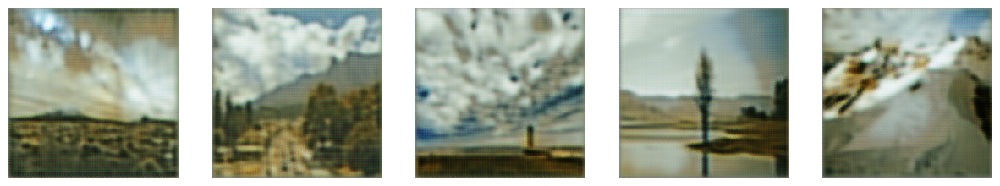

Epoch 1 | Avg Generator Loss: 10.2329 | Avg Discriminator Loss: 0.6208

Epoch 2/40


  2%|▏         | 40/1760 [00:37<26:41,  1.07it/s]


Epoch 2 Sample 0: min=-0.894, max=1.000
Epoch 2 Sample 1: min=-0.899, max=0.989
Epoch 2 Sample 2: min=-0.969, max=0.992
Epoch 2 Sample 3: min=-0.962, max=0.980
Epoch 2 Sample 4: min=-0.975, max=0.996


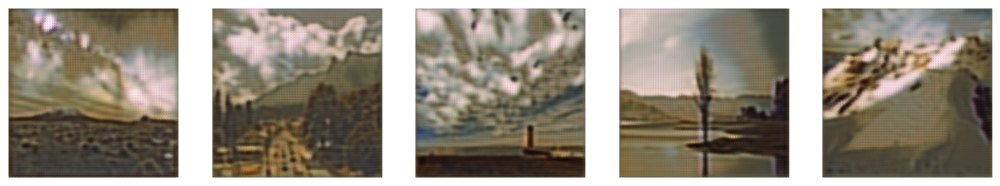

Epoch 2 | Avg Generator Loss: 9.2731 | Avg Discriminator Loss: 0.4890

Epoch 3/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 3 Sample 0: min=-0.921, max=0.969
Epoch 3 Sample 1: min=-0.897, max=0.907
Epoch 3 Sample 2: min=-0.920, max=0.813
Epoch 3 Sample 3: min=-0.935, max=0.791
Epoch 3 Sample 4: min=-0.992, max=0.932


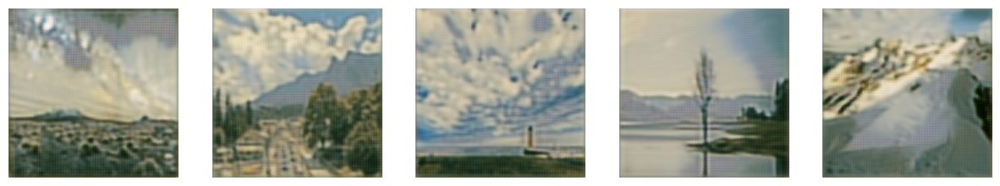

Epoch 3 | Avg Generator Loss: 8.9284 | Avg Discriminator Loss: 0.4813

Epoch 4/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 4 Sample 0: min=-0.947, max=0.997
Epoch 4 Sample 1: min=-0.969, max=0.919
Epoch 4 Sample 2: min=-0.926, max=0.862
Epoch 4 Sample 3: min=-0.959, max=0.825
Epoch 4 Sample 4: min=-0.995, max=0.962


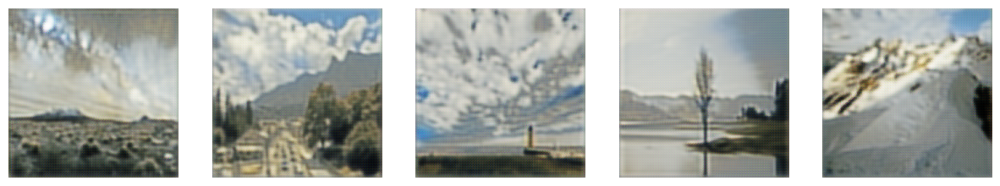

Epoch 4 | Avg Generator Loss: 8.5117 | Avg Discriminator Loss: 0.4512

Epoch 5/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 5 Sample 0: min=-0.928, max=0.974
Epoch 5 Sample 1: min=-0.935, max=0.841
Epoch 5 Sample 2: min=-0.965, max=0.814
Epoch 5 Sample 3: min=-0.951, max=0.839
Epoch 5 Sample 4: min=-0.997, max=0.900


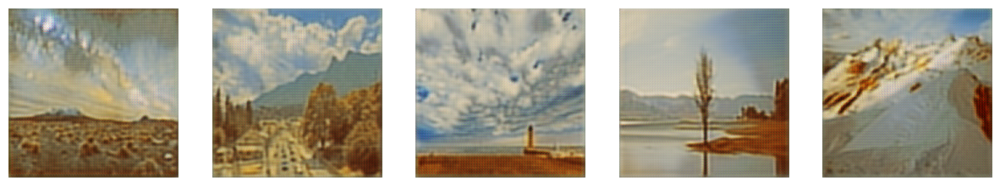

Epoch 5 | Avg Generator Loss: 8.3335 | Avg Discriminator Loss: 0.4459

Epoch 6/40


  2%|▏         | 40/1760 [00:37<26:41,  1.07it/s]


Epoch 6 Sample 0: min=-0.862, max=0.992
Epoch 6 Sample 1: min=-0.886, max=0.854
Epoch 6 Sample 2: min=-0.903, max=0.848
Epoch 6 Sample 3: min=-0.872, max=0.828
Epoch 6 Sample 4: min=-0.975, max=0.933


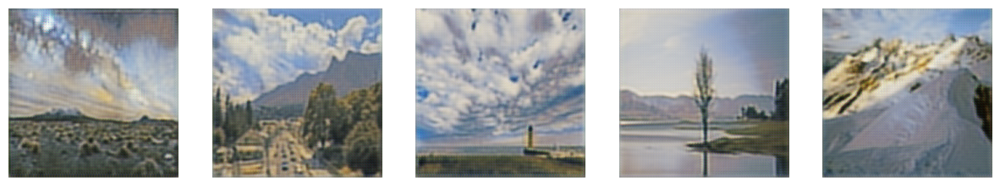

Epoch 6 | Avg Generator Loss: 7.6278 | Avg Discriminator Loss: 0.4396

Epoch 7/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 7 Sample 0: min=-0.946, max=0.999
Epoch 7 Sample 1: min=-0.966, max=0.968
Epoch 7 Sample 2: min=-0.962, max=0.922
Epoch 7 Sample 3: min=-0.944, max=0.917
Epoch 7 Sample 4: min=-0.997, max=0.978


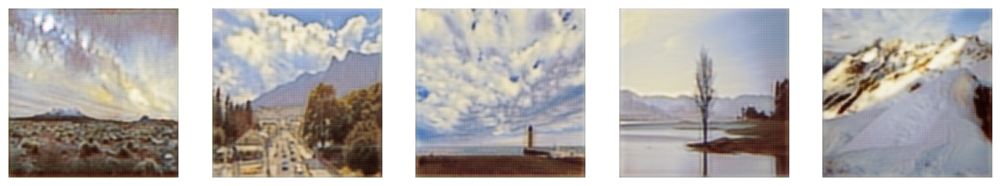

Epoch 7 | Avg Generator Loss: 7.8228 | Avg Discriminator Loss: 0.4452

Epoch 8/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 8 Sample 0: min=-0.947, max=0.999
Epoch 8 Sample 1: min=-0.959, max=0.948
Epoch 8 Sample 2: min=-0.951, max=0.949
Epoch 8 Sample 3: min=-0.940, max=0.956
Epoch 8 Sample 4: min=-0.998, max=0.949


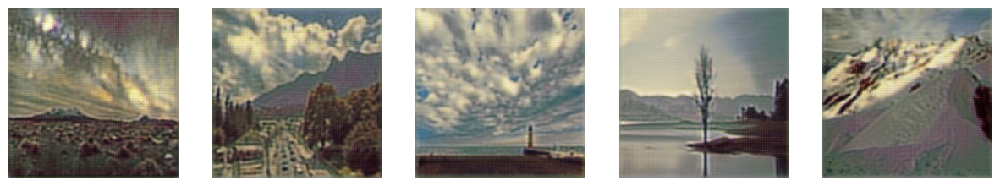

Epoch 8 | Avg Generator Loss: 7.7688 | Avg Discriminator Loss: 0.4140

Epoch 9/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 9 Sample 0: min=-0.947, max=0.987
Epoch 9 Sample 1: min=-0.925, max=0.862
Epoch 9 Sample 2: min=-0.960, max=0.881
Epoch 9 Sample 3: min=-0.926, max=0.883
Epoch 9 Sample 4: min=-0.993, max=0.920


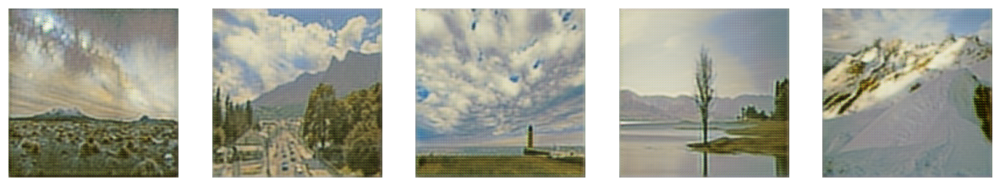

Epoch 9 | Avg Generator Loss: 7.6496 | Avg Discriminator Loss: 0.4072

Epoch 10/40


  2%|▏         | 40/1760 [00:37<26:41,  1.07it/s]


Epoch 10 Sample 0: min=-0.969, max=0.991
Epoch 10 Sample 1: min=-0.979, max=0.937
Epoch 10 Sample 2: min=-0.985, max=0.915
Epoch 10 Sample 3: min=-0.955, max=0.892
Epoch 10 Sample 4: min=-0.998, max=0.961


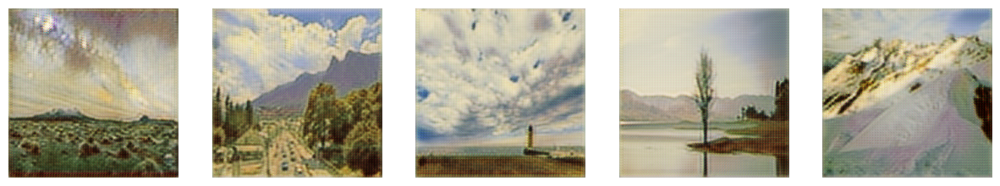

Epoch 10 | Avg Generator Loss: 7.4454 | Avg Discriminator Loss: 0.4273

Epoch 11/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 11 Sample 0: min=-0.856, max=1.000
Epoch 11 Sample 1: min=-0.821, max=0.950
Epoch 11 Sample 2: min=-0.856, max=0.932
Epoch 11 Sample 3: min=-0.873, max=0.971
Epoch 11 Sample 4: min=-0.961, max=0.975


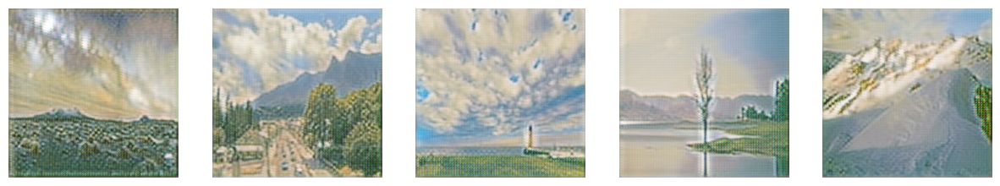

Epoch 11 | Avg Generator Loss: 7.5571 | Avg Discriminator Loss: 0.3940

Epoch 12/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 12 Sample 0: min=-0.978, max=1.000
Epoch 12 Sample 1: min=-0.968, max=0.965
Epoch 12 Sample 2: min=-0.994, max=0.961
Epoch 12 Sample 3: min=-0.975, max=0.968
Epoch 12 Sample 4: min=-0.999, max=0.989


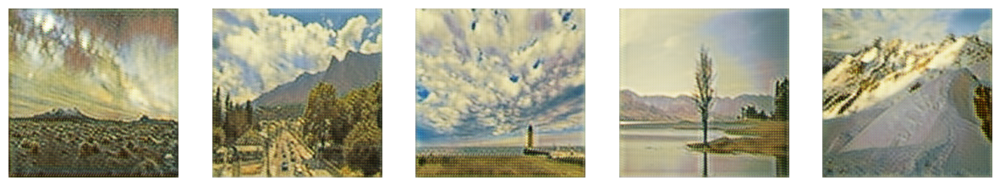

Epoch 12 | Avg Generator Loss: 7.8336 | Avg Discriminator Loss: 0.3821

Epoch 13/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 13 Sample 0: min=-0.953, max=0.992
Epoch 13 Sample 1: min=-0.940, max=0.860
Epoch 13 Sample 2: min=-0.978, max=0.836
Epoch 13 Sample 3: min=-0.956, max=0.860
Epoch 13 Sample 4: min=-0.992, max=0.906


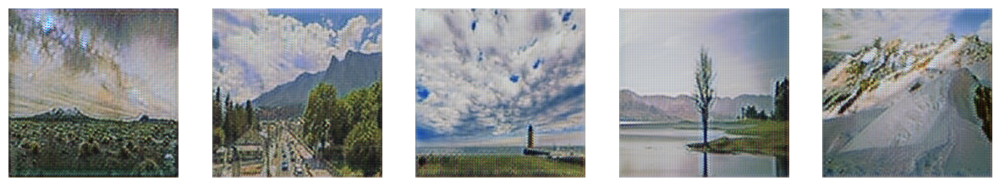

Epoch 13 | Avg Generator Loss: 7.1841 | Avg Discriminator Loss: 0.3918

Epoch 14/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 14 Sample 0: min=-0.941, max=0.994
Epoch 14 Sample 1: min=-0.900, max=0.887
Epoch 14 Sample 2: min=-0.953, max=0.913
Epoch 14 Sample 3: min=-0.934, max=0.937
Epoch 14 Sample 4: min=-0.987, max=0.937


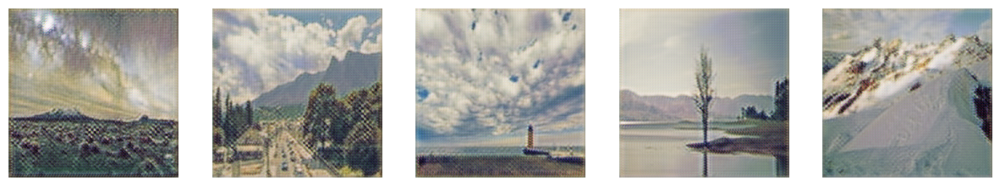

Epoch 14 | Avg Generator Loss: 7.1962 | Avg Discriminator Loss: 0.3798

Epoch 15/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 15 Sample 0: min=-0.975, max=0.999
Epoch 15 Sample 1: min=-0.944, max=0.888
Epoch 15 Sample 2: min=-0.973, max=0.874
Epoch 15 Sample 3: min=-0.947, max=0.902
Epoch 15 Sample 4: min=-0.995, max=0.957


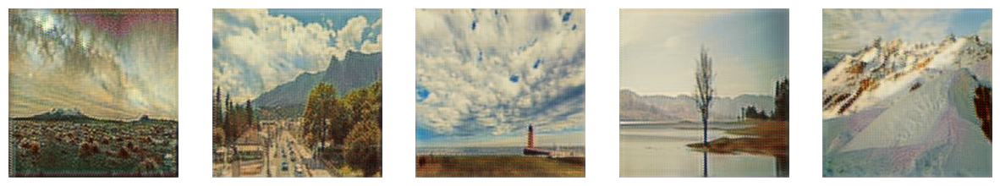

Epoch 15 | Avg Generator Loss: 7.0527 | Avg Discriminator Loss: 0.3916

Epoch 16/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 16 Sample 0: min=-0.943, max=1.000
Epoch 16 Sample 1: min=-0.909, max=0.947
Epoch 16 Sample 2: min=-0.905, max=0.917
Epoch 16 Sample 3: min=-0.870, max=0.965
Epoch 16 Sample 4: min=-0.970, max=0.973


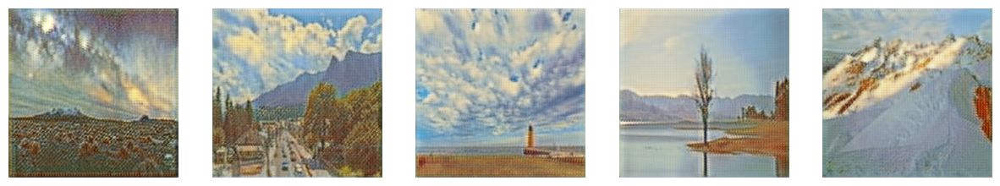

Epoch 16 | Avg Generator Loss: 7.2562 | Avg Discriminator Loss: 0.3907

Epoch 17/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 17 Sample 0: min=-0.962, max=0.993
Epoch 17 Sample 1: min=-0.947, max=0.906
Epoch 17 Sample 2: min=-0.968, max=0.901
Epoch 17 Sample 3: min=-0.953, max=0.983
Epoch 17 Sample 4: min=-0.986, max=0.923


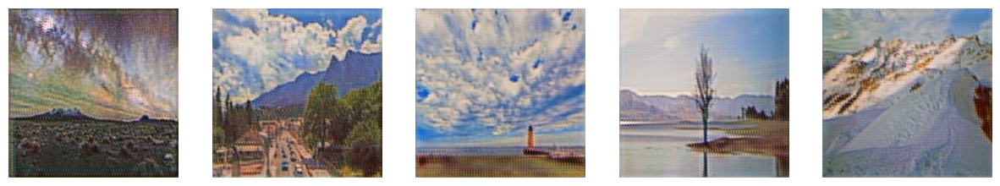

Epoch 17 | Avg Generator Loss: 7.0145 | Avg Discriminator Loss: 0.3835

Epoch 18/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 18 Sample 0: min=-0.962, max=0.998
Epoch 18 Sample 1: min=-0.956, max=0.907
Epoch 18 Sample 2: min=-0.945, max=0.868
Epoch 18 Sample 3: min=-0.959, max=0.921
Epoch 18 Sample 4: min=-0.988, max=0.946


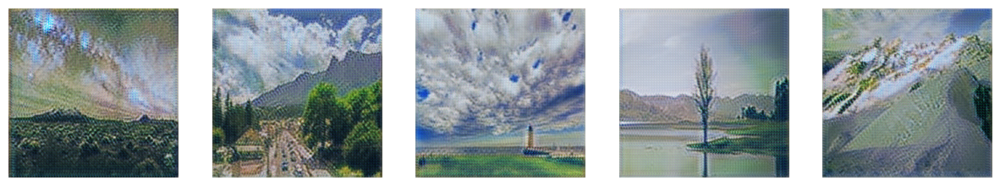

Epoch 18 | Avg Generator Loss: 7.4366 | Avg Discriminator Loss: 0.3696

Epoch 19/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 19 Sample 0: min=-0.978, max=0.999
Epoch 19 Sample 1: min=-0.979, max=0.954
Epoch 19 Sample 2: min=-0.992, max=0.935
Epoch 19 Sample 3: min=-0.981, max=0.954
Epoch 19 Sample 4: min=-0.995, max=0.957


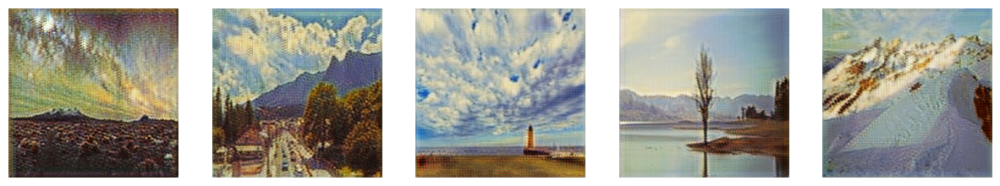

Epoch 19 | Avg Generator Loss: 7.0423 | Avg Discriminator Loss: 0.3845

Epoch 20/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 20 Sample 0: min=-0.972, max=0.993
Epoch 20 Sample 1: min=-0.955, max=0.908
Epoch 20 Sample 2: min=-0.974, max=0.901
Epoch 20 Sample 3: min=-0.950, max=0.897
Epoch 20 Sample 4: min=-0.992, max=0.920


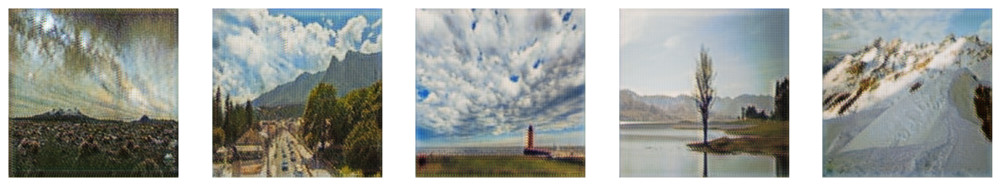

Epoch 20 | Avg Generator Loss: 6.8670 | Avg Discriminator Loss: 0.3892

Epoch 21/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 21 Sample 0: min=-0.955, max=0.996
Epoch 21 Sample 1: min=-0.943, max=0.897
Epoch 21 Sample 2: min=-0.984, max=0.933
Epoch 21 Sample 3: min=-0.953, max=0.931
Epoch 21 Sample 4: min=-0.982, max=0.964


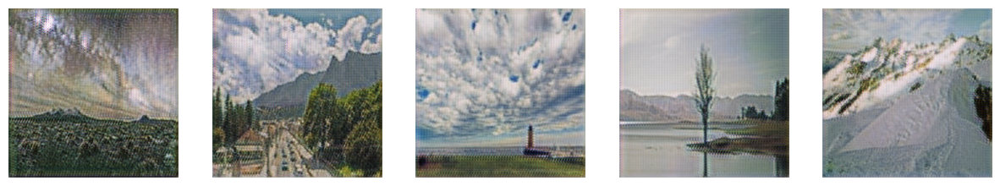

Epoch 21 | Avg Generator Loss: 6.8099 | Avg Discriminator Loss: 0.3874

Epoch 22/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 22 Sample 0: min=-0.987, max=0.966
Epoch 22 Sample 1: min=-0.975, max=0.791
Epoch 22 Sample 2: min=-0.998, max=0.871
Epoch 22 Sample 3: min=-0.978, max=0.794
Epoch 22 Sample 4: min=-0.997, max=0.899


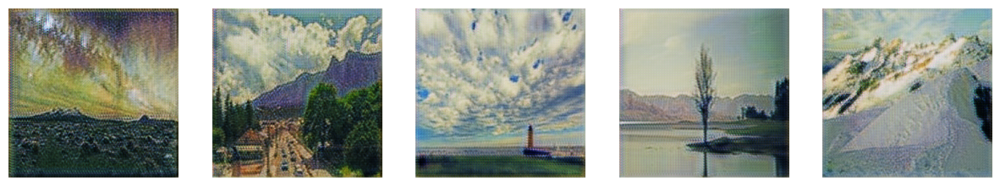

Epoch 22 | Avg Generator Loss: 6.6532 | Avg Discriminator Loss: 0.3776

Epoch 23/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 23 Sample 0: min=-0.986, max=0.991
Epoch 23 Sample 1: min=-0.977, max=0.900
Epoch 23 Sample 2: min=-0.986, max=0.902
Epoch 23 Sample 3: min=-0.983, max=0.959
Epoch 23 Sample 4: min=-0.990, max=0.949


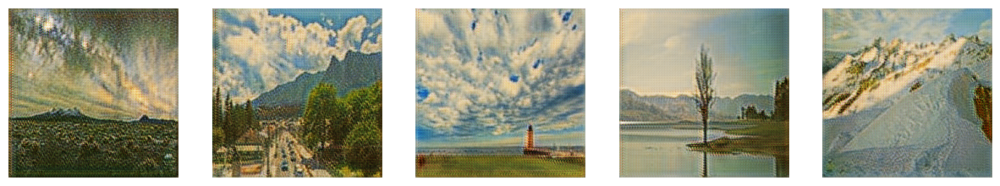

Epoch 23 | Avg Generator Loss: 6.6356 | Avg Discriminator Loss: 0.3826

Epoch 24/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 24 Sample 0: min=-0.960, max=0.971
Epoch 24 Sample 1: min=-0.923, max=0.922
Epoch 24 Sample 2: min=-0.980, max=0.931
Epoch 24 Sample 3: min=-0.932, max=0.891
Epoch 24 Sample 4: min=-0.990, max=0.941


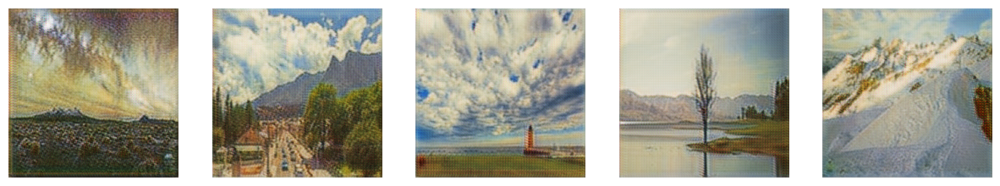

Epoch 24 | Avg Generator Loss: 6.7243 | Avg Discriminator Loss: 0.3799

Epoch 25/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 25 Sample 0: min=-0.951, max=0.992
Epoch 25 Sample 1: min=-0.945, max=0.940
Epoch 25 Sample 2: min=-0.973, max=0.952
Epoch 25 Sample 3: min=-0.945, max=0.933
Epoch 25 Sample 4: min=-0.986, max=0.988


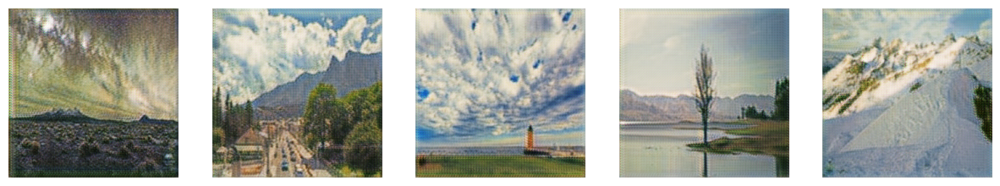

Epoch 25 | Avg Generator Loss: 6.5292 | Avg Discriminator Loss: 0.3861

Epoch 26/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 26 Sample 0: min=-0.971, max=0.962
Epoch 26 Sample 1: min=-0.965, max=0.882
Epoch 26 Sample 2: min=-0.979, max=0.935
Epoch 26 Sample 3: min=-0.942, max=0.896
Epoch 26 Sample 4: min=-0.995, max=0.936


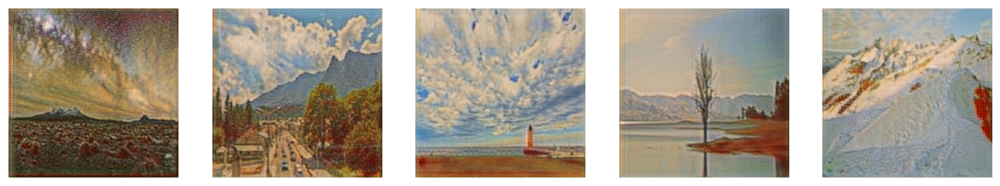

Epoch 26 | Avg Generator Loss: 6.4796 | Avg Discriminator Loss: 0.3955

Epoch 27/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 27 Sample 0: min=-0.947, max=0.967
Epoch 27 Sample 1: min=-0.921, max=0.883
Epoch 27 Sample 2: min=-0.974, max=0.911
Epoch 27 Sample 3: min=-0.940, max=0.950
Epoch 27 Sample 4: min=-0.990, max=0.957


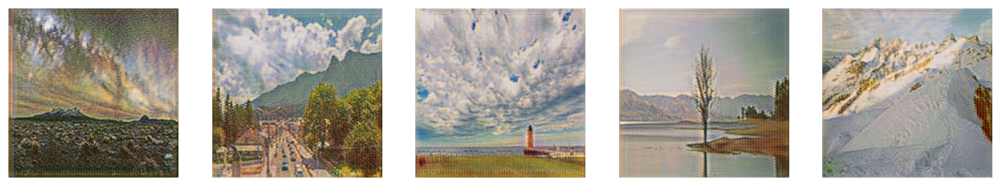

Epoch 27 | Avg Generator Loss: 6.5181 | Avg Discriminator Loss: 0.3782

Epoch 28/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 28 Sample 0: min=-0.963, max=0.991
Epoch 28 Sample 1: min=-0.971, max=0.946
Epoch 28 Sample 2: min=-0.967, max=0.927
Epoch 28 Sample 3: min=-0.961, max=0.941
Epoch 28 Sample 4: min=-0.994, max=0.969


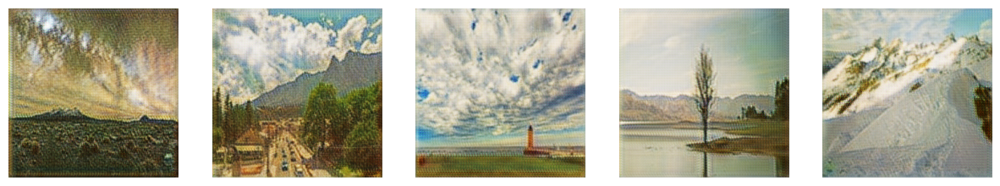

Epoch 28 | Avg Generator Loss: 6.3969 | Avg Discriminator Loss: 0.3736

Epoch 29/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 29 Sample 0: min=-0.941, max=0.988
Epoch 29 Sample 1: min=-0.906, max=0.841
Epoch 29 Sample 2: min=-0.920, max=0.864
Epoch 29 Sample 3: min=-0.911, max=0.839
Epoch 29 Sample 4: min=-0.961, max=0.898


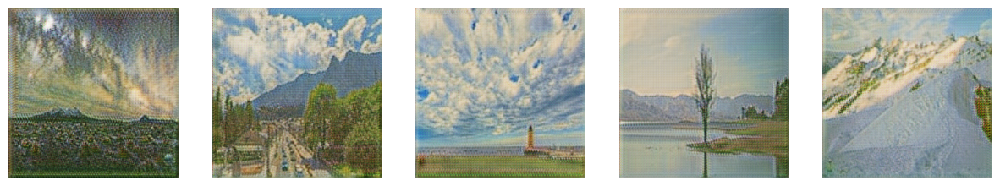

Epoch 29 | Avg Generator Loss: 6.5246 | Avg Discriminator Loss: 0.3845

Epoch 30/40


  2%|▏         | 40/1760 [00:37<26:40,  1.07it/s]


Epoch 30 Sample 0: min=-0.981, max=0.964
Epoch 30 Sample 1: min=-0.970, max=0.871
Epoch 30 Sample 2: min=-0.949, max=0.920
Epoch 30 Sample 3: min=-0.968, max=0.922
Epoch 30 Sample 4: min=-0.986, max=0.957


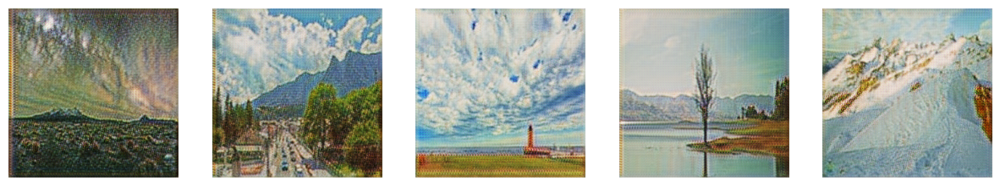

Epoch 30 | Avg Generator Loss: 6.4371 | Avg Discriminator Loss: 0.4029

Epoch 31/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 31 Sample 0: min=-0.987, max=0.984
Epoch 31 Sample 1: min=-0.970, max=0.914
Epoch 31 Sample 2: min=-0.980, max=0.899
Epoch 31 Sample 3: min=-0.936, max=0.925
Epoch 31 Sample 4: min=-0.996, max=0.954


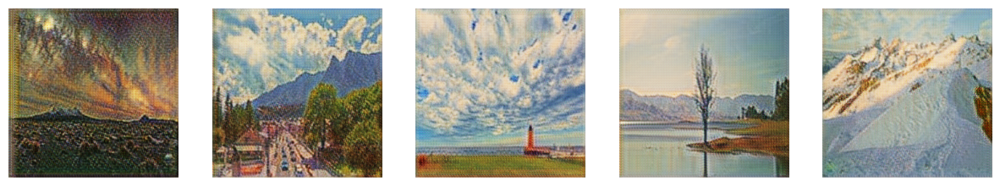

Epoch 31 | Avg Generator Loss: 6.3672 | Avg Discriminator Loss: 0.3734

Epoch 32/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 32 Sample 0: min=-0.954, max=0.976
Epoch 32 Sample 1: min=-0.952, max=0.900
Epoch 32 Sample 2: min=-0.963, max=0.882
Epoch 32 Sample 3: min=-0.940, max=0.899
Epoch 32 Sample 4: min=-0.988, max=0.936


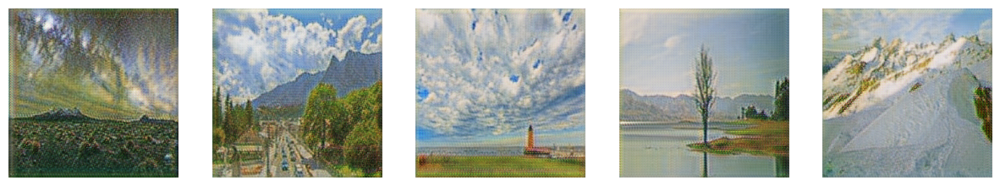

Epoch 32 | Avg Generator Loss: 6.4563 | Avg Discriminator Loss: 0.3895

Epoch 33/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 33 Sample 0: min=-0.982, max=0.977
Epoch 33 Sample 1: min=-0.957, max=0.920
Epoch 33 Sample 2: min=-0.969, max=0.924
Epoch 33 Sample 3: min=-0.956, max=0.940
Epoch 33 Sample 4: min=-0.992, max=0.956


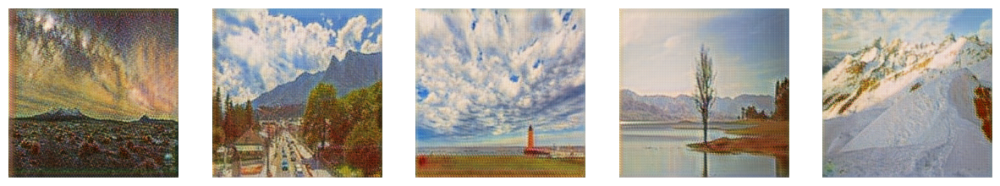

Epoch 33 | Avg Generator Loss: 6.0036 | Avg Discriminator Loss: 0.3964

Epoch 34/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 34 Sample 0: min=-0.958, max=0.948
Epoch 34 Sample 1: min=-0.927, max=0.864
Epoch 34 Sample 2: min=-0.882, max=0.857
Epoch 34 Sample 3: min=-0.925, max=0.830
Epoch 34 Sample 4: min=-0.990, max=0.895


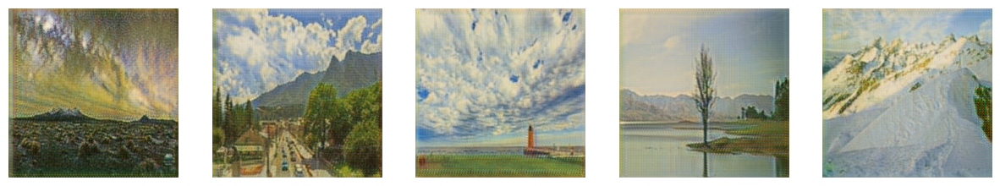

Epoch 34 | Avg Generator Loss: 6.3960 | Avg Discriminator Loss: 0.3644

Epoch 35/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 35 Sample 0: min=-0.930, max=0.985
Epoch 35 Sample 1: min=-0.913, max=0.890
Epoch 35 Sample 2: min=-0.921, max=0.845
Epoch 35 Sample 3: min=-0.898, max=0.900
Epoch 35 Sample 4: min=-0.966, max=0.922


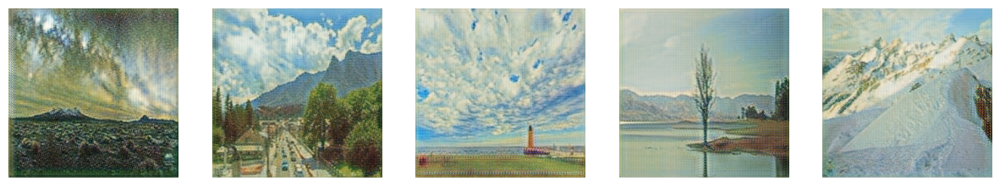

Epoch 35 | Avg Generator Loss: 6.0776 | Avg Discriminator Loss: 0.3832

Epoch 36/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 36 Sample 0: min=-0.976, max=0.930
Epoch 36 Sample 1: min=-0.928, max=0.821
Epoch 36 Sample 2: min=-0.976, max=0.844
Epoch 36 Sample 3: min=-0.921, max=0.881
Epoch 36 Sample 4: min=-0.987, max=0.889


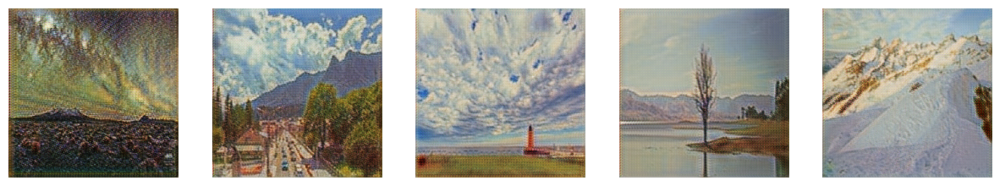

Epoch 36 | Avg Generator Loss: 6.0919 | Avg Discriminator Loss: 0.4026

Epoch 37/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 37 Sample 0: min=-0.959, max=0.910
Epoch 37 Sample 1: min=-0.920, max=0.822
Epoch 37 Sample 2: min=-0.938, max=0.831
Epoch 37 Sample 3: min=-0.950, max=0.791
Epoch 37 Sample 4: min=-0.971, max=0.885


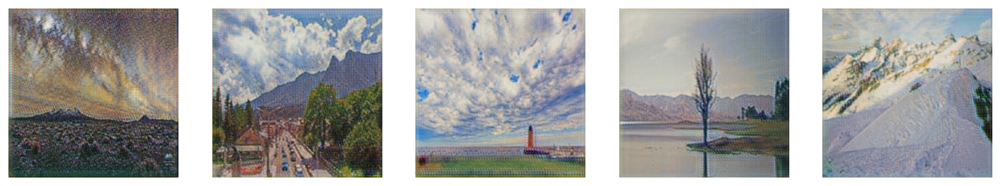

Epoch 37 | Avg Generator Loss: 5.9638 | Avg Discriminator Loss: 0.3865

Epoch 38/40


  2%|▏         | 40/1760 [00:37<26:39,  1.08it/s]


Epoch 38 Sample 0: min=-0.969, max=0.968
Epoch 38 Sample 1: min=-0.948, max=0.931
Epoch 38 Sample 2: min=-0.945, max=0.921
Epoch 38 Sample 3: min=-0.965, max=0.924
Epoch 38 Sample 4: min=-0.989, max=0.949


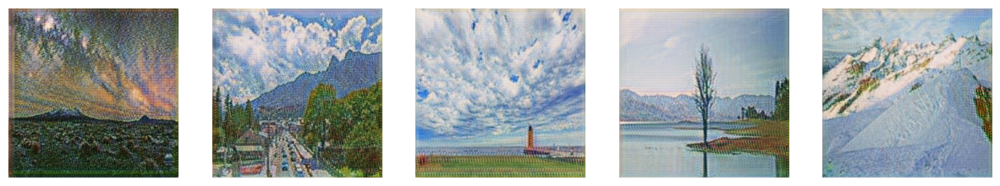

Epoch 38 | Avg Generator Loss: 5.9644 | Avg Discriminator Loss: 0.3775

Epoch 39/40


  2%|▏         | 40/1760 [00:37<26:38,  1.08it/s]


Epoch 39 Sample 0: min=-0.966, max=0.986
Epoch 39 Sample 1: min=-0.924, max=0.920
Epoch 39 Sample 2: min=-0.972, max=0.942
Epoch 39 Sample 3: min=-0.930, max=0.930
Epoch 39 Sample 4: min=-0.989, max=0.955


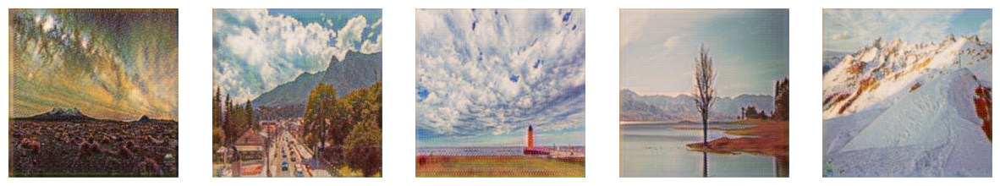

Epoch 39 | Avg Generator Loss: 5.9888 | Avg Discriminator Loss: 0.3906

Epoch 40/40


  2%|▏         | 40/1760 [00:37<26:47,  1.07it/s]


Epoch 40 Sample 0: min=-0.967, max=0.960
Epoch 40 Sample 1: min=-0.944, max=0.880
Epoch 40 Sample 2: min=-0.922, max=0.846
Epoch 40 Sample 3: min=-0.907, max=0.882
Epoch 40 Sample 4: min=-0.973, max=0.903


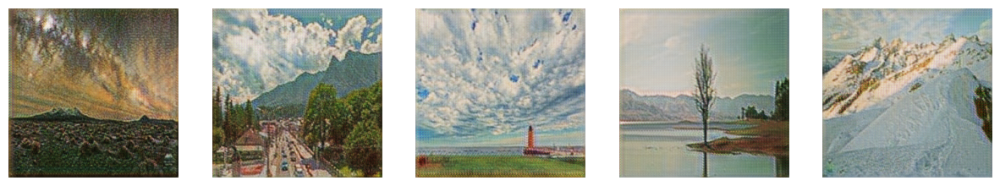

Epoch 40 | Avg Generator Loss: 5.8384 | Avg Discriminator Loss: 0.3838


In [11]:
# Pick a small set of photos for monitoring
SAMPLE_SIZE = 5
sample_photo_paths = random.sample(photo_paths, SAMPLE_SIZE)

for epoch in range(NUM_EPOCHS):
    print(f"\nEpoch {epoch+1}/{NUM_EPOCHS}")
    g_loss_epoch = 0.0
    d_loss_epoch = 0.0

    for step, batch in enumerate(tqdm(loader)):
        if step >= MAX_STEPS:
            break  # limit steps per epoch

        real_monet = batch["monet"].to(device)
        real_photo = batch["photo"].to(device)

        
        # Train Discriminators
        fake_monet = G_PHOTO2MONET(real_photo).detach()
        fake_photo = G_MONET2PHOTO(real_monet).detach()

        d_opt.zero_grad()

        d_real_monet = D_MONET(real_monet)
        d_fake_monet = D_MONET(fake_monet)
        d_real_photo = D_PHOTO(real_photo)
        d_fake_photo = D_PHOTO(fake_photo)

        real_labels = torch.ones_like(d_real_monet)
        fake_labels = torch.zeros_like(d_fake_monet)

        d_loss_monet = adv_criterion(d_real_monet, real_labels) + adv_criterion(d_fake_monet, fake_labels)
        d_loss_photo = adv_criterion(d_real_photo, real_labels) + adv_criterion(d_fake_photo, fake_labels)

        d_loss = 0.5 * (d_loss_monet + d_loss_photo)
        d_loss.backward()
        d_opt.step()


        # Train Generators
        g_opt.zero_grad()

        fake_monet = G_PHOTO2MONET(real_photo)
        fake_photo = G_MONET2PHOTO(real_monet)

        pred_fake_monet = D_MONET(fake_monet)
        pred_fake_photo = D_PHOTO(fake_photo)

        adv_loss = adv_criterion(pred_fake_monet, real_labels) + adv_criterion(pred_fake_photo, real_labels)

        cycle_photo = G_MONET2PHOTO(fake_monet)
        cycle_monet = G_PHOTO2MONET(fake_photo)
        cycle_loss = cycle_criterion(cycle_photo, real_photo) + cycle_criterion(cycle_monet, real_monet)

        id_photo = G_MONET2PHOTO(real_photo)
        id_monet = G_PHOTO2MONET(real_monet)
        id_loss = identity_criterion(id_photo, real_photo) + identity_criterion(id_monet, real_monet)

        g_loss = adv_loss + LAMBDA_CYCLE * cycle_loss + LAMBDA_IDENTITY * id_loss
        g_loss.backward()
        g_opt.step()

        g_loss_epoch += g_loss.item()
        d_loss_epoch += d_loss.item()


    # Generate Test Samples for Monitoring
    G_PHOTO2MONET.eval()
    with torch.no_grad():
        fig, axes = plt.subplots(1, SAMPLE_SIZE, figsize=(15, 5))
        for idx, img_path in enumerate(sample_photo_paths):
            img = Image.open(img_path).convert("RGB")
            img = transforms(img).unsqueeze(0).to(device)

            fake_monet = G_PHOTO2MONET(img)
            print(f"Epoch {epoch+1} Sample {idx}: min={fake_monet.min().item():.3f}, max={fake_monet.max().item():.3f}")

            # Denormalize
            fake_monet_img = (fake_monet[0] * 0.5 + 0.5).clamp(0, 1)
            fake_monet_img = T.ToPILImage()(fake_monet_img.cpu())
            axes[idx].imshow(fake_monet_img)
            axes[idx].axis("off")
        plt.show()
    G_PHOTO2MONET.train()

    print(f"Epoch {epoch+1} | Avg Generator Loss: {g_loss_epoch/MAX_STEPS:.4f} | Avg Discriminator Loss: {d_loss_epoch/MAX_STEPS:.4f}")

<h1>Result and Analysis</h1>

Training Improvements:

Epochs: Increased from 20 to 40

Max steps per epoch: Increased from 20 to 40

Batch size: 4

Result: 91.08062 to 76.96256

These changes gave the generator more exposure to the training images and helped the model improve the Monet-style details. Ideally, more epochs and steps and less batch size would produce even better results, but we were limited by GPU memory and training time.

<h2>Test output with samples</h2>
Test with a Small number of images for a quick result

In [12]:
# Test Generation: Small Sample

NUM_TEST_IMAGES = 10  # small number for quick test
os.makedirs("test_images", exist_ok=True)

with torch.no_grad():
    for idx in range(NUM_TEST_IMAGES):
        # Pick a random photo from the dataset
        img_path = random.choice(photo_paths)
        img = Image.open(img_path).convert("RGB")
        img = transforms(img).unsqueeze(0).to(device)

        # Generate Monet-style image
        fake_monet = G_PHOTO2MONET(img)
        fake_monet = (fake_monet[0] * 0.5 + 0.5).clamp(0, 1)
        fake_monet = T.ToPILImage()(fake_monet.cpu())

        # Save test image
        fake_monet.save(f"test_images/{idx}.jpg")

print("Test generation complete. Check 'test_images/' folder for outputs.")


Test generation complete. Check 'test_images/' folder for outputs.


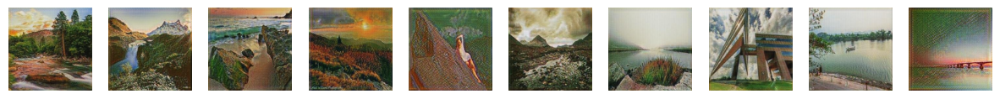

In [13]:
# Get test images
test_imgs = sorted(glob("test_images/*.jpg"))

# Set up plot
fig, axes = plt.subplots(1, len(test_imgs), figsize=(15, 5))

for ax, img_path in zip(axes, test_imgs):
    img = Image.open(img_path)
    ax.imshow(img)
    ax.axis("off")

plt.show()

In [14]:
# GENERATE SUBMISSION IMAGES
import zipfile

from torchvision.utils import save_image

SUBMISSION_DIR = "images"  # folder for all images
os.makedirs(SUBMISSION_DIR, exist_ok=True)


# Generate Images
photo_files = glob(PHOTO_JPG + "*.jpg")
N_IMAGES = 7000  

print(f"Generating {N_IMAGES} Monet-style images...")

G_PHOTO2MONET.eval() # set generator to eval mode
with torch.no_grad():
    for idx, img_path in enumerate(tqdm(photo_files[:N_IMAGES])):
        img = Image.open(img_path).convert("RGB")
        img = transforms(img).unsqueeze(0).to(device)

        monet = G_PHOTO2MONET(img)[0].cpu()
        monet = (monet * 0.5 + 0.5).clamp(0, 1)  # denormalize to [0,1]

        # Save as 256x256 JPG
        save_image(monet, f"{SUBMISSION_DIR}/{idx}.jpg")

print("Completed. Total images:", len(os.listdir(SUBMISSION_DIR)))


# Create ZIP for submission
zip_filename = "images.zip"
with zipfile.ZipFile(zip_filename, 'w') as zipf:
    for file in sorted(os.listdir(SUBMISSION_DIR)):
        zipf.write(os.path.join(SUBMISSION_DIR, file), arcname=file)

print(f"Submission zip created: {zip_filename}")


Generating 7000 Monet-style images...


100%|██████████| 7000/7000 [02:00<00:00, 57.98it/s]


Completed. Total images: 7000
Submission zip created: images.zip


<h1>Conclusion</h1>
In this project, we built a CycleGAN to generate Monet style images from regular photos. The model consists of ResNet-based generators and PatchGAN discriminators, which work together to learn the style transformation without paired datasets.

By increasing the number of epochs and max steps per epoch, the model was able to produce 7,000 high-quality Monet-style images with realistic colors, textures, and content preservation. The residual blocks helped maintain the structure of the original photos, and the PatchGAN discriminators encouraged the generator to focus on realistic local textures.

Future Work

While the current model produces good results, training is time and resource intensive. Future work could focus on:

Efficient hyperparameter search: Develop methods to find good learning rates, batch sizes, and generator/discriminator configurations without needing long training times.

Faster training strategies: Explore smaller models, mixed-precision training, or progressive image resizing to reduce computation.

Improved style quality: Investigate additional loss functions or attention mechanisms to capture finer brushstroke details.

Data augmentation: Use clever augmentation strategies to increase diversity and improve style transfer performance.

Overall, this project demonstrates that CycleGAN can effectively learn Monet style image generation, and there is potential to further optimize training for faster results with comparable quality.

<h1>Reference</h1>
What is a GAN? https://aws.amazon.com/what-is/gan/

Monet cyclegan tutorial: https://www.kaggle.com/code/amyjang/monet-cyclegan-tutorial


<h1>GitHub</h1>
https://github.com/meng-shi/GAN-Monet